# Eurovision Song Contest Data

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [4]:
euro_df = pd.read_csv('/home/marcus/LinCode/DataEngineerProject/Kaggle Dataset/song_data.csv', encoding = 'latin-1') 
regions = pd.read_csv('/home/marcus/LinCode/DataEngineerProject/Kaggle Dataset/country_data.csv')

In [5]:
pd.set_option('display.max_columns', None)
euro_df

,year,semi_final,semi_draw_position,final_draw_position,country,artist_name,song_name,language,style,direct_qualifier_10,gender,main_singers,age,selection,key,BPM,energy,danceability,happiness,loudness,acousticness,instrumentalness,liveness,speechiness,release_date,key_change_10,backing_dancers,backing_singers,backing_instruments,instrument_10,qualified_10,final_televote_points,final_jury_points,final_televote_votes,final_jury_votes,final_place,final_total_points,semi_place,semi_televote_points,semi_jury_points,semi_total_points,favourite_10,race,host_10
0,2023,1,1,20,Norway,Alessandra,Queen of Kings,English,Pop,0,Female,1,unknown,unknown,E Minor,110,36,64,23,10 dB,58,0,10,3,unknown,unknown,4,0,0,0,1,216.0,52.0,36.0,11.0,5.0,268.0,6.0,102.0,NaN,102.0,0,unknown,0
1,2023,1,2,NaN,Malta,The Busker,Dance (Our Own Party),English,Pop,-,Male,1,unknown,unknown,F Minor,103,78,70,82,6 dB,2,0,18,4,unknown,unknown,0,0,2,0,0,NaN,NaN,NaN,NaN,NaN,NaN,15.0,3.0,NaN,3.0,0,unknown,0
2,2023,1,3,5,Serbia,Luke Black,Samo mi se spava,"Serbian, English",Pop,0,Male,1,unknown,unknown,A Major,103,70,56,11,10 dB,4,2,32,5,unknown,unknown,4,0,0,0,1,16.0,14.0,4.0,6.0,24.0,30.0,10.0,37.0,NaN,37.0,0,unknown,0
3,2023,1,4,NaN,Latvia,Sudden Lights,Aija,English,Rock,-,Male,1,unknown,unknown,A Minor,160,55,56,40,8 dB,5,0,8,7,unknown,unknown,0,0,3,0,0,NaN,NaN,NaN,NaN,NaN,NaN,11.0,34.0,NaN,34.0,0,unknown,0
4,2023,1,5,2,Portugal,Mimicat,Ai coraï¿½ï¿½o,Portuguese,Pop,0,Female,1,unknown,unknown,Fs Minor,145,63,66,77,8 dB,31,0,16,5,unknown,unknown,4,0,0,0,1,16.0,43.0,3.0,9.0,23.0,59.0,9.0,74.0,NaN,74.0,0,unknown,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
560,2009,-,-,3,France,Patricia Kaas,Et s'il fallait le faire,French,Ballad,1,Female,1,unknown,unknown,A Major,92,58,26,23,8 dB,55,0,90,8,unknown,unknown,0,0,0,0,-,54.0,164.0,NaN,NaN,8.0,218.0,NaN,NaN,NaN,NaN,0,unknown,0
561,2009,-,-,10,Russia,Anastasiya Prikhodko,Mamo,"Russian,ï¿½Ukrainian",Ballad,1,Female,1,unknown,unknown,D Minor,130,94,64,45,4 dB,41,0,26,5,unknown,unknown,0,5,0,0,-,118.0,67.0,NaN,NaN,11.0,185.0,NaN,NaN,NaN,NaN,0,unknown,1
562,2009,-,-,17,Germany,Alexï¿½Swingsï¿½Oscarï¿½Sings!,Miss Kiss Kiss Bang,English,Pop,1,Male,1,unknown,unknown,Bb Minor,136,89,62,56,4 dB,11,0,20,21,unknown,unknown,3,1,1,0,-,18.0,73.0,NaN,NaN,20.0,91.0,NaN,NaN,NaN,NaN,0,unknown,0
563,2009,-,-,23,United Kingdom,Jade Ewen,It's My Time,English,Ballad,1,Female,1,unknown,unknown,E Major,105,31,30,12,14 dB,1,79,29,3,unknown,unknown,0,0,5,0,-,105.0,223.0,NaN,NaN,5.0,328.0,NaN,NaN,NaN,NaN,0,unknown,0


In [6]:
euro_df = euro_df.replace('unknown', np.nan)

In [7]:
euro_df = euro_df.drop(['direct_qualifier_10', 'age', 'selection', 'release_date', 
                        'key_change_10', 'race', 'semi_final'], axis=1)

In [8]:
euro_df = euro_df.merge(regions, how = 'left', on = 'country')

In [9]:
finalists = euro_df[euro_df['qualified_10'] != '0']

In [10]:
finalists = finalists.drop(['semi_draw_position', 'qualified_10', 'semi_place', 'semi_televote_points', 
                            'semi_jury_points', 'semi_total_points'], axis=1)

### Which countries are the most consistent?

In [11]:
countries = finalists.groupby(['country', 'region']).agg({'country': 'count', 
                                                          'final_place': ['mean', 'min', 'max'], 
                                                          'final_total_points': ['mean', 'max', 'min'], 
                                                          'final_televote_points': 'mean', 
                                                          'final_jury_points': 'mean'})

countries.columns = ['Participation #', 'Avg place', 'Best place', 'Worst place', 'Avg total points', 
                     'Max total points', 'Min total points', 'Avg televote pts', 'Avg jury pts']

print('Top countries:')
display(countries.sort_values('Avg place').round(2).head(10))
print('And how does it look at the bottom of the standings..?')
display(countries.sort_values('Avg place', ascending = False).round(2).head(10))

Top countries:


,,Participation #,Avg place,Best place,Worst place,Avg total points,Max total points,Min total points,Avg televote pts,Avg jury pts
country,region,,,,,,,,,
Turkey,Eastern Europe,3,4.33,2.0,7.0,279.67,317.0,226.0,185.33,94.33
Sweden,Scandanavia,13,6.46,1.0,21.0,342.62,639.0,62.0,170.00,196.00
Italy,Western Europe,12,6.83,1.0,21.0,304.58,527.0,59.0,155.36,165.45
Russia,Eastern Europe,10,6.90,2.0,16.0,289.70,520.0,163.0,188.44,114.11
Bulgaria,Eastern Europe,4,7.75,2.0,14.0,314.50,615.0,166.0,153.25,161.25
Ukraine,Eastern Europe,12,8.67,1.0,24.0,262.00,631.0,36.0,163.82,102.55
Netherlands,Western Europe,8,9.25,1.0,18.0,183.50,498.0,23.0,87.29,130.71
North Macedonia,Eastern Europe,2,10.00,7.0,13.0,188.00,305.0,71.0,58.00,247.00
Belgium,Western Europe,8,10.12,4.0,19.0,196.50,376.0,64.0,90.14,124.29


And how does it look at the bottom of the standings..?


,,Participation #,Avg place,Best place,Worst place,Avg total points,Max total points,Min total points,Avg televote pts,Avg jury pts
country,region,,,,,,,,,
San Marino,Western Europe,3,21.50,19.0,24.0,54.00,77.0,31.0,31.33,21.33
Belarus,Eastern Europe,5,19.40,16.0,24.0,61.60,106.0,31.0,28.50,36.50
United Kingdom,Western Europe,14,19.14,2.0,26.0,103.00,466.0,0.0,50.67,66.75
Spain,Western Europe,14,18.93,3.0,26.0,101.43,459.0,5.0,51.54,57.08
Germany,Western Europe,14,18.64,1.0,27.0,107.07,430.0,3.0,57.62,56.31
Ireland,Western Europe,5,18.40,8.0,26.0,108.20,220.0,5.0,66.75,67.25
Slovenia,Eastern Europe,6,18.33,13.0,25.0,90.83,199.0,36.0,37.17,53.67
Croatia,Eastern Europe,3,18.00,13.0,23.0,104.67,128.0,73.0,63.67,41.00
Finland,Scandanavia,8,16.88,2.0,25.0,154.75,526.0,13.0,119.14,55.86


<Axes: xlabel='Avg total points', ylabel='country'>

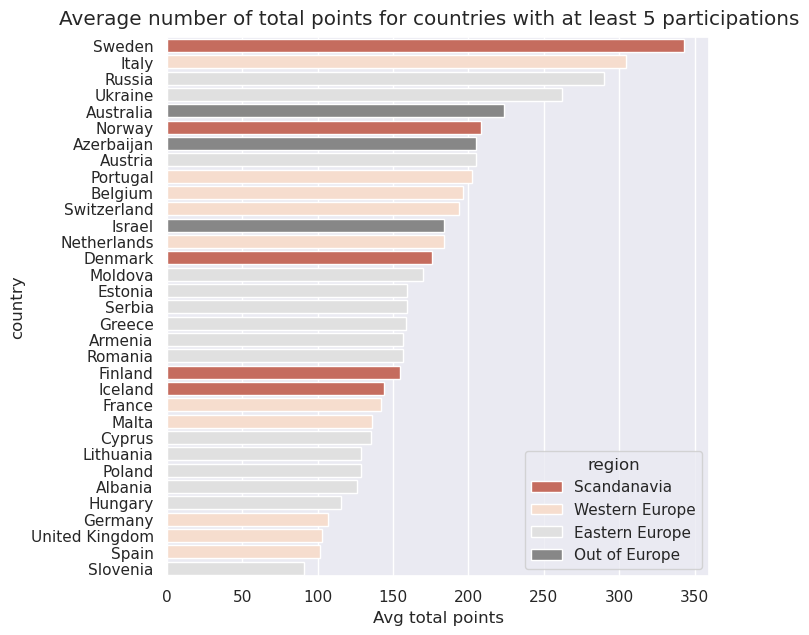

In [12]:
countries = countries.reset_index()
plt.figure(figsize=(7,7))
sns.set_theme(style = 'darkgrid')
plt.suptitle('Average number of total points for countries with at least 5 participations', y = 0.92)

sns.barplot(data = countries[countries['Participation #'] > 5].sort_values('Avg total points', 
                                                                          ascending = False), 
           x = 'Avg total points', y = 'country', hue = 'region', dodge = False, palette = 'RdGy')

### Are there regional differences?

In [13]:
regions = finalists.groupby(['region'])[['final_place', 'final_total_points']].mean()
regions.columns = ['Avg place', 'Avg total points']
regions.sort_values('Avg place').round(2)

,Avg place,Avg total points
region,,
Scandanavia,11.44,218.50
Out of Europe,11.62,194.75
Eastern Europe,13.16,166.60
Western Europe,15.13,155.19


### Is the genre important?

<Axes: xlabel='style', ylabel='final_total_points'>

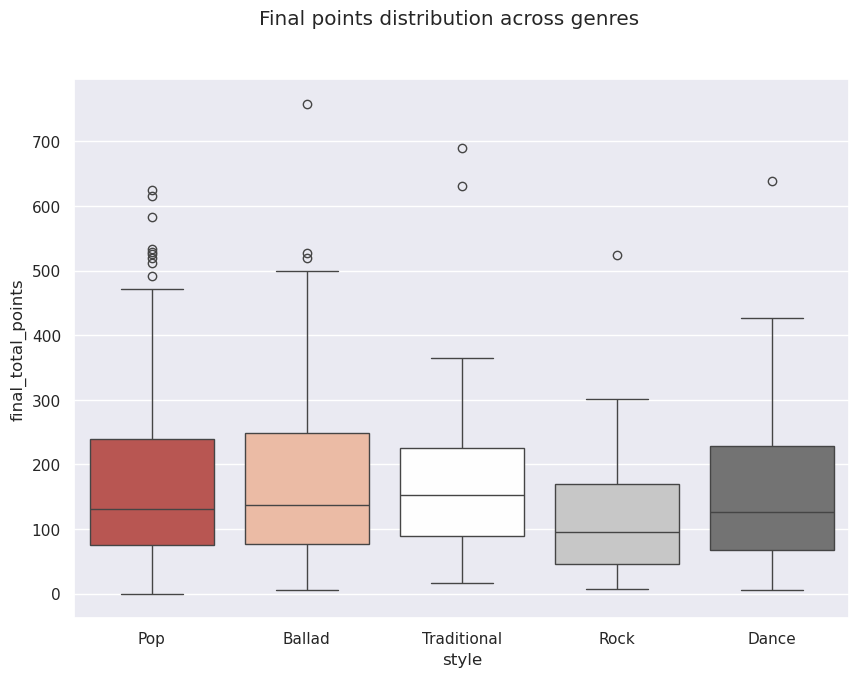

In [14]:
plt.figure(figsize=(10,7))
plt.suptitle('Final points distribution across genres')
sns.boxplot(data = finalists[finalists['style'] != 'Opera'], 
           x = 'style', y = 'final_total_points', palette = 'RdGy')

In [15]:
genres = finalists.groupby(['style']).agg({'style': 'count', 
                                           'final_place': 'mean', 
                                           'final_jury_points': 'mean', 
                                          'final_televote_points': 'mean', 
                                           'final_total_points': 'mean'})

genres.columns = ['N', 'Avg final place', 'Avg jury points', 'Avg televote points', 'Avg total points']
genres['Jury-televote diff'] = genres['Avg jury points'] - genres['Avg televote points']
genres.sort_values('Avg final place').round(2)

,N,Avg final place,Avg jury points,Avg televote points,Avg total points,Jury-televote diff
style,,,,,,
Opera,3,10.00,107.00,112.00,219.00,-5.00
Ballad,98,12.66,107.24,80.04,180.72,27.20
Traditional,29,12.86,76.44,121.41,184.72,-44.96
Pop,163,13.44,91.64,88.27,174.39,3.38
Dance,39,14.05,67.09,113.79,166.32,-46.70
Rock,27,15.74,74.29,78.14,126.26,-3.86


<Axes: xlabel='style', ylabel='Jury-televote diff'>

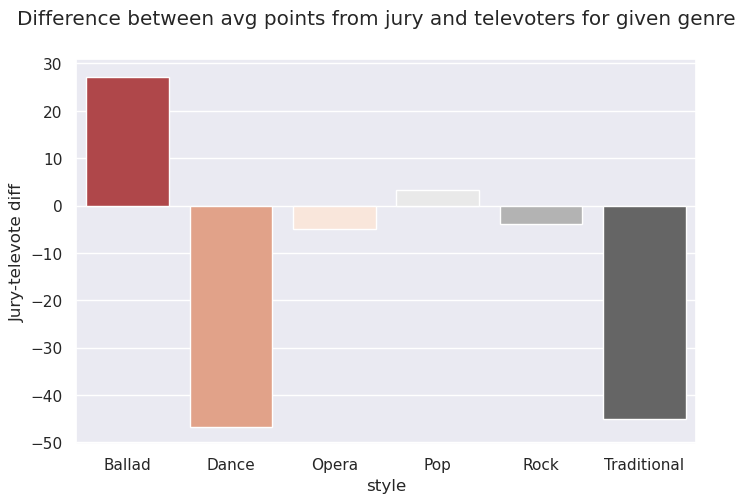

In [16]:
plt.figure(figsize=(8,5))
plt.suptitle('Difference between avg points from jury and televoters for given genre')
sns.barplot(data = genres.reset_index(), x = 'style', y = 'Jury-televote diff', palette = 'RdGy')

Ballads are the most successful at eurovision, but this seems to be the case mainly due to jury preferences. Televoters are more keen on Dance and Traditional styles.

### Is it better to sing in English or in a native language?

In [17]:
def language(x):
    if x == 'English': return 'English'
    elif x.find(',') > 0: return 'Mixed' #if there is a comma it means that more than 1 language was used in a song
    else: return 'Native'

In [18]:
finalists['language2'] = finalists['language'].apply(language)

<Axes: xlabel='language2', ylabel='final_total_points'>

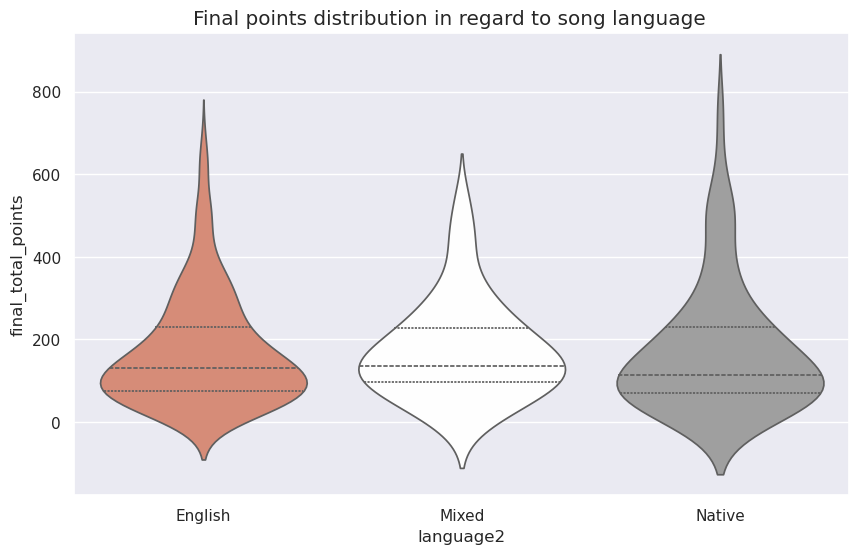

In [19]:
plt.figure(figsize = (10,6))
plt.suptitle('Final points distribution in regard to song language', y = 0.92)
sns.violinplot(data = finalists, x = 'language2', y = 'final_total_points', 
              inner="quart", fill=True, palette = 'RdGy')

In [20]:
languages = finalists.groupby(['language2']).agg({'language2': 'count', 
                                                  'final_place': 'mean', 
                                                  'final_televote_points': 'mean',
                                                 'final_jury_points': 'mean', 
                                                  'final_total_points': 'mean'})

languages.columns = ['N', 'Avg place', 'Avg televote points', 'Avg jury points', 'Avg total points']
languages['Jury-televote diff'] = languages['Avg jury points'] - languages['Avg televote points']
languages.sort_values('Avg place').round(2)

,N,Avg place,Avg televote points,Avg jury points,Avg total points,Jury-televote diff
language2,,,,,,
Mixed,39,12.74,94.41,80.31,175.03,-14.10
English,243,13.41,86.63,93.65,171.52,7.02
Native,77,13.65,102.90,89.58,175.88,-13.31


<Axes: xlabel='language2', ylabel='Jury-televote diff'>

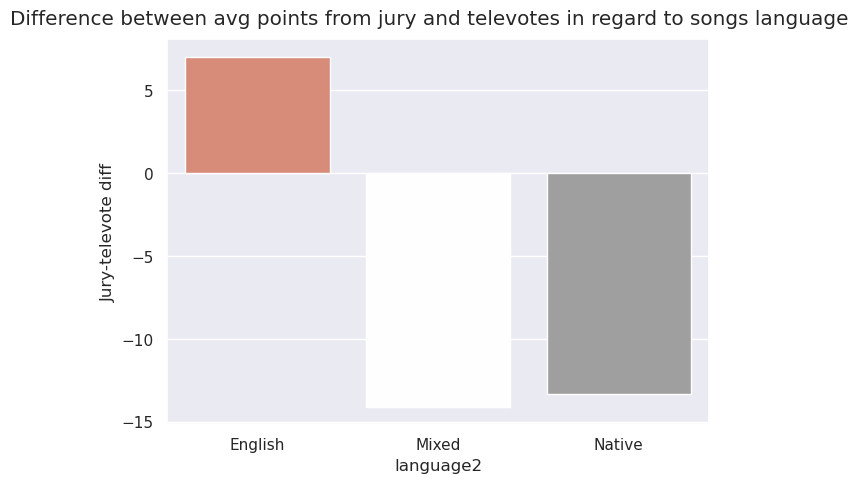

In [21]:
plt.figure(figsize=(7,5))
plt.suptitle('Difference between avg points from jury and televotes in regard to songs language', 
             y = 0.94)

sns.barplot(data = languages.reset_index(), x = 'language2', y = 'Jury-televote diff', palette = 'RdGy')

### Which song characteristics are associated with good final score?

In [22]:
finalists.rename(columns = {'loudness':'loudness(dB)'}, inplace = True)
finalists['loudness(dB)'] = finalists['loudness(dB)'].str.replace(' dB', '')
finalists['loudness(dB)']

0      10
2      10
4       8
7       5
8       5
       ..
560     8
561     4
562     4
563    14
564     7
Name: loudness(dB), Length: 359, dtype: object

In [23]:
finalists.iloc[:,10:19] = finalists.iloc[:,10:19].replace('-', np.nan)
finalists.iloc[:,10:19] = finalists.iloc[:,10:19].astype(float)

<Axes: xlabel='speechiness', ylabel='final_total_points'>

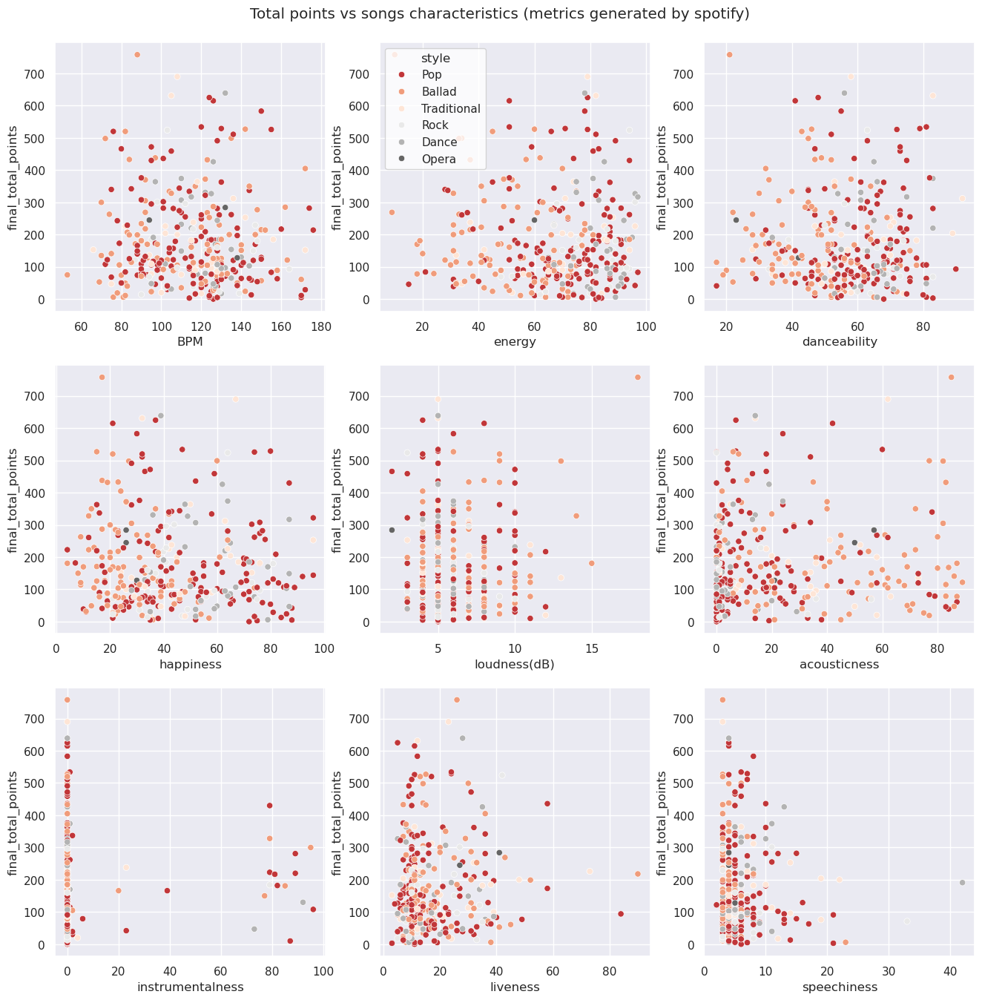

In [24]:
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6), (ax7, ax8, ax9)) = plt.subplots(3, 3, figsize = (16,16))
sns.set_theme(style = 'white', palette = 'RdGy')
fig.suptitle('Total points vs songs characteristics (metrics generated by spotify)', y = 0.91)

sns.scatterplot(data = finalists, x = 'BPM', y = 'final_total_points', 
               hue = 'style', ax = ax1, legend = False)
sns.scatterplot(data = finalists, x = 'energy', y = 'final_total_points', 
               hue = 'style', ax = ax2)
sns.scatterplot(data = finalists, x = 'danceability', y = 'final_total_points', 
               hue = 'style', ax = ax3, legend = False)
sns.scatterplot(data = finalists, x = 'happiness', y = 'final_total_points', 
               hue = 'style', ax = ax4, legend = False)
sns.scatterplot(data = finalists, x = 'loudness(dB)', y = 'final_total_points', 
               hue = 'style', ax = ax5, legend = False)
sns.scatterplot(data = finalists, x = 'acousticness', y = 'final_total_points', 
               hue = 'style', ax = ax6, legend = False)
sns.scatterplot(data = finalists, x = 'instrumentalness', y = 'final_total_points', 
               hue = 'style', ax = ax7, legend = False)
sns.scatterplot(data = finalists, x = 'liveness', y = 'final_total_points', 
               hue = 'style', ax = ax8, legend = False)
sns.scatterplot(data = finalists, x = 'speechiness', y = 'final_total_points', 
               hue = 'style', ax = ax9, legend = False)

<Axes: >

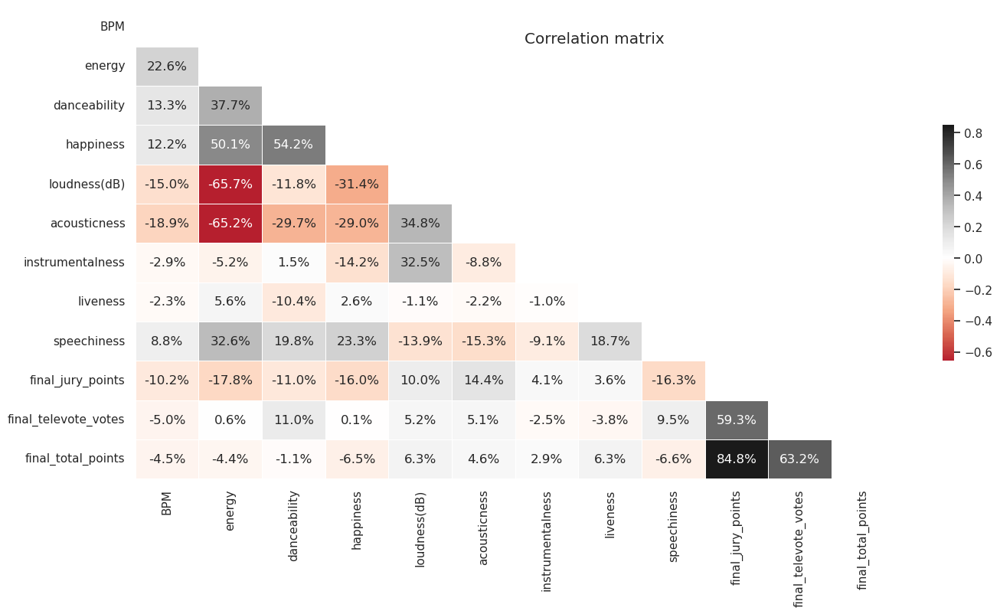

In [25]:
corr = finalists[['BPM', 'energy', 'danceability', 'happiness', 'loudness(dB)', 'acousticness', 'instrumentalness', 
                  'liveness', 'speechiness', 'final_jury_points', 'final_televote_votes', 'final_total_points']].corr()

mask = np.triu(np.ones_like(corr, dtype=bool))

fig, ax = plt.subplots(figsize=(16, 8))
fig.suptitle('Correlation matrix', y = 0.84)
sns.heatmap(corr, annot=True, fmt='.1%', mask=mask, cmap='RdGy', center=0, linewidths=.5, cbar_kws={"shrink": .5})

### Is there a home advantage?

In [26]:
host = finalists.groupby(['host_10']).agg({'final_place': 'mean', 
                                           'final_jury_points': 'mean', 
                                           'final_televote_points': 'mean',
                                          'final_total_points': 'mean'})

host.columns = ['Avg final place', 'Avg jury points', 'Avg televote points', 'Avg total points']
host.index = ['Others', 'Host']
host.round(2)

,Avg final place,Avg jury points,Avg televote points,Avg total points
Others,13.31,92.68,91.90,175.04
Host,15.29,56.23,66.15,118.93


No home advantage. If anything it hurts your chances of winning if you host.

### Are bookmakers good at predicting the winner?

In [27]:
finalists['winner'] = [1 if x == 1 else 0 for x in finalists['final_place']]
finalists['top_3'] = [1 if x < 4 else 0 for x in finalists['final_place']]

In [28]:
pred_true = finalists.loc[(finalists['winner'] == 1) & (finalists['favourite_10'] == 1)]
print(f'{len(pred_true)} out of 14 winners were predicted.')
display(pred_true)

9 out of 14 winners were predicted.


,year,final_draw_position,country,artist_name,song_name,language,style,gender,main_singers,key,BPM,energy,danceability,happiness,loudness(dB),acousticness,instrumentalness,liveness,speechiness,backing_dancers,backing_singers,backing_instruments,instrument_10,final_televote_points,final_jury_points,final_televote_votes,final_jury_votes,final_place,final_total_points,favourite_10,host_10,region,language2,winner,top_3
10,2023,9,Sweden,Loreen,Tattoo,English,Pop,Female,1,Eb Minor,150.0,78.0,55.0,30.0,6.0,24.0,0.0,12.0,8.0,0,0,0,0,243.0,340.0,36.0,36.0,1.0,583.0,1,0,Scandanavia,English,1,1
42,2022,12,Ukraine,Kalush Orchestra,Stefania,Ukrainian,Traditional,Male,1,D Major,105.0,82.0,83.0,32.0,5.0,14.0,0.0,12.0,4.0,1,2,2,0,439.0,192.0,39.0,26.0,1.0,631.0,1,0,Eastern Europe,Native,1,1
148,2019,12,Netherlands,Duncan Laurence,Arcade,English,Ballad,Male,1,A Minor,72.0,33.0,45.0,27.0,13.0,82.0,0.0,14.0,4.0,0,0,0,1,261.0,237.0,40.0,32.0,1.0,498.0,1,0,Western Europe,English,1,1
163,2018,22,Israel,Netta,Toy,English,Pop,Female,1,Eb Minor,130.0,71.0,79.0,80.0,5.0,7.0,0.0,24.0,7.0,3,0,0,0,317.0,212.0,39.0,34.0,1.0,529.0,1,0,Out of Europe,English,1,1
312,2015,10,Sweden,Mans Zelmerlow,Heroes,English,Pop,Male,1,G Major,124.0,79.0,48.0,37.0,4.0,7.0,0.0,5.0,4.0,0,0,0,0,353.0,272.0,38.0,37.0,1.0,625.0,1,0,Scandanavia,English,1,1
364,2013,18,Denmark,Emmelie de Forest,Only Teardrops,English,Pop,Female,1,C Major,128.0,86.0,62.0,23.0,10.0,0.0,89.0,36.0,3.0,0,3,2,0,NaN,NaN,NaN,NaN,1.0,281.0,1,0,Scandanavia,English,1,1
427,2012,17,Sweden,Loreen,Euphoria,English,Dance,Female,1,B Minor,132.0,78.0,56.0,39.0,5.0,14.0,0.0,28.0,4.0,1,0,0,0,343.0,296.0,NaN,NaN,1.0,639.0,1,0,Scandanavia,English,1,1
522,2010,22,Germany,Lena,Satellite,English,Pop,Female,1,E Minor,95.0,94.0,75.0,87.0,10.0,0.0,79.0,10.0,5.0,0,4,0,0,243.0,187.0,NaN,NaN,1.0,430.0,1,0,Western Europe,English,1,1
546,2009,20,Norway,Alexander Rybak,Fairytale,English,Traditional,Male,1,D Minor,108.0,79.0,58.0,67.0,5.0,62.0,0.0,23.0,3.0,3,2,0,1,378.0,312.0,NaN,NaN,1.0,690.0,1,0,Scandanavia,English,1,1


### Oddeties

In [29]:
finalists.loc[finalists['final_total_points'] == 0]

,year,final_draw_position,country,artist_name,song_name,language,style,gender,main_singers,key,BPM,energy,danceability,happiness,loudness(dB),acousticness,instrumentalness,liveness,speechiness,backing_dancers,backing_singers,backing_instruments,instrument_10,final_televote_points,final_jury_points,final_televote_votes,final_jury_votes,final_place,final_total_points,favourite_10,host_10,region,language2,winner,top_3
112,2021,9,United Kingdom,James Newman,Embers,English,Pop,Male,1,Fs Major,126.0,82.0,68.0,72.0,5.0,0.0,0.0,11.0,6.0,0,0,4,0,0.0,0.0,0.0,0.0,26.0,0.0,0,0,Western Europe,English,0,0


There is a single song that made it to the finals but recieved 0 total points

### Is there a gender gap?

In [30]:
sn.set_theme(style = 'dark', palette = 'RdGy')
fig, (ax1, ax2) = plt.subplots(1, 2, figsize = (12,6))
plt.suptitle('Distribution of final place and total points by gender', y = 0.95)
sns.boxplot(data = finalists, x = 'gender', y = 'final_place', ax = ax1)
sns.boxplot(data = finalists, x = 'gender', y = 'final_total_points', ax = ax2)

NameError: name 'sn' is not defined

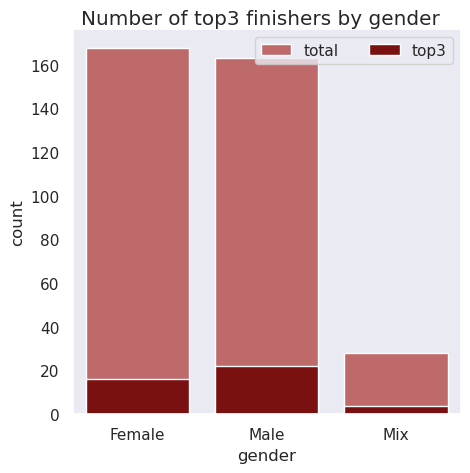

In [29]:
fig, ax = plt.subplots(figsize=(5, 5))

sns.countplot(data = finalists, x = 'gender', label = 'total', color = 'indianred')
sns.countplot(data = finalists.loc[finalists['top_3'] == 1], x = 'gender', 
             label = 'top3', color = 'darkred')

plt.suptitle('Number of top3 finishers by gender', y = 0.92)
ax.legend(ncol=2, loc="upper right", frameon=True)

Males finish in the top 3 slightly more often even though there are more women who has competed.  
Maybe it's because of different genre preferences between them?

<Axes: xlabel='style', ylabel='count'>

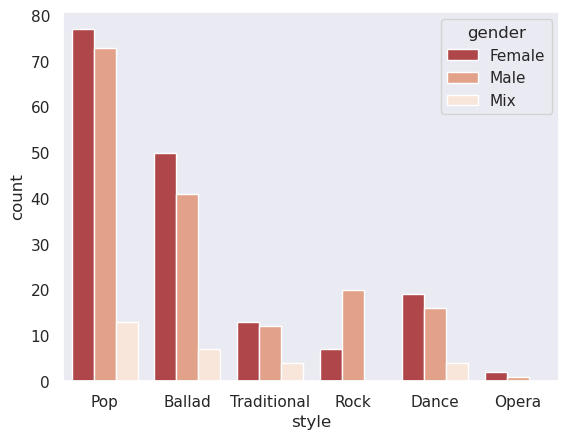

In [30]:
sns.countplot(data = finalists, x = 'style', hue = 'gender')

No, genre does not seem to be the reason since all but Rock is more often chosen by women.

### Do people prefer sad or cheerful songs? (minor vs major key)

In [31]:
finalists['key'] = finalists['key'].replace('-', np.nan)
finalists['key2'] = finalists['key'].str.split(expand = True)[1]
finalists['key2'].value_counts()

key2
Minor    177
Major    143
Name: count, dtype: int64

<Axes: xlabel='key2', ylabel='final_televote_points'>

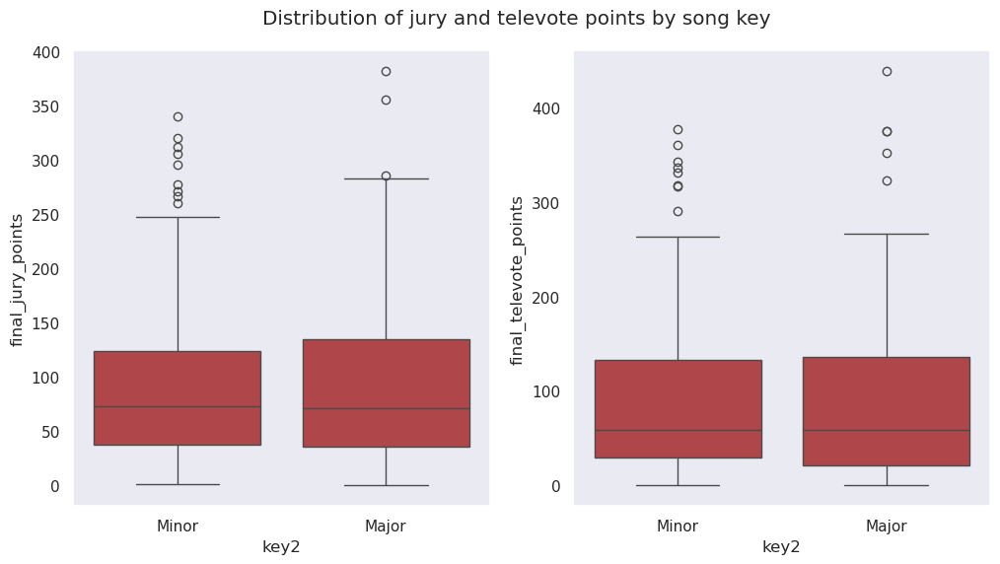

In [32]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize = (12,6))
plt.suptitle('Distribution of jury and televote points by song key', y = 0.95)
sns.boxplot(data = finalists, y = 'final_jury_points', x = 'key2', ax = ax1)
sns.boxplot(data = finalists, y = 'final_televote_points', x = 'key2', ax = ax2)

There is no significant difference in medians, but it seems that the very best scores were achieved mostly by songs in minor key.

In [33]:
finalists.groupby(['key2']).agg({'winner': 'sum', 'top_3': 'sum', 'final_total_points': 'mean'})

,winner,top_3,final_total_points
key2,,,
Major,6,17,173.762238
Minor,8,23,180.560000


As we can see among the songs that finished in top3 more were written in minor key.  
We can conclude that sad songs have slightly higher chances to succeed at eurovision but the difference is not huge.

### Strength in numbers?

Is it better to perform alone? Or the more people on the stage the better?

In [35]:
finalists['performers_count'] = finalists[['main_singers', 'backing_singers', 
                                           'backing_dancers', 'backing_instruments']].sum(axis=1)

finalists['solo'] = ['alone' if x == 1 else 'group' for x in finalists['performers_count']]
finalists['solo'].value_counts()

solo
group    287
alone     72
Name: count, dtype: int64

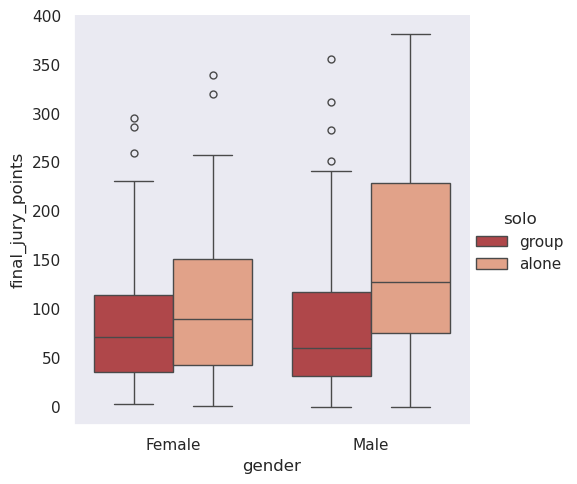

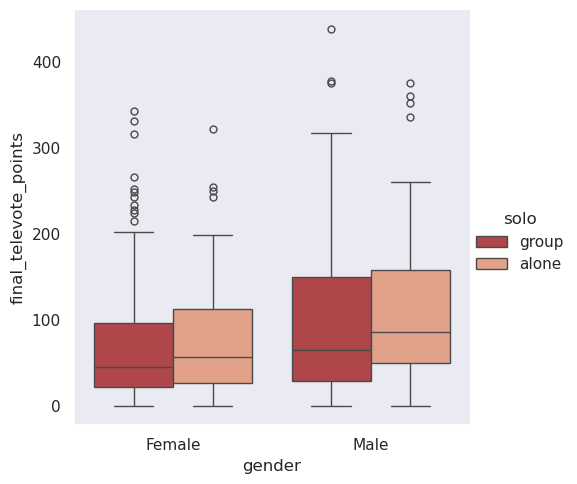

In [41]:
sns.catplot(data = finalists.loc[finalists['gender'] != 'Mix'], 
           y = 'final_jury_points', x = 'gender', hue = 'solo', kind = 'box')
sns.catplot(data = finalists.loc[finalists['gender'] != 'Mix'], 
           y = 'final_televote_points', x = 'gender', hue = 'solo', kind = 'box')

It seems that it's better to perform alone, especially if you are male. This preference is more visible among the jury.

In [44]:
finalists.groupby(['performers_count']).agg({'performers_count': 'count', 
                                             'final_place': 'mean', 
                                             'final_total_points': 'mean'}).sort_values('final_place').round(2)

,performers_count,final_place,final_total_points
performers_count,,,
7,1,8.00,220.00
9,1,11.00,184.00
1,72,11.22,226.06
3,29,12.79,172.00
2,22,13.59,157.05
6,119,13.68,170.71
4,26,14.50,153.46
5,89,14.67,141.79


### Is there a recency bias?

Does the draw position in final has any significance?

In [45]:
finalists['final_draw_position'] = finalists['final_draw_position'].replace('-', np.nan)
finalists['final_draw_position'] = finalists['final_draw_position'].astype(float)
finalists['final_order'] = pd.cut(finalists['final_draw_position'], [0,5,10,15,20,27])
finalists['final_order'].value_counts()

final_order
(20, 27]    79
(0, 5]      70
(5, 10]     70
(15, 20]    70
(10, 15]    68
Name: count, dtype: int64

In [46]:
finalists[['final_place', 'final_total_points', 'final_draw_position']].corr()

,final_place,final_total_points,final_draw_position
final_place,1.000000,-0.852833,-0.168384
final_total_points,-0.852833,1.000000,0.188127
final_draw_position,-0.168384,0.188127,1.000000


In [47]:
order = finalists.groupby(['final_order']).agg({'final_order': 'count', 
                                                'final_place': 'mean', 
                                                'final_jury_points': 'mean', 
                                                'final_televote_points': 'mean',
                                                'winner': 'sum', 
                                                'top_3': 'sum'})

order.columns = ['Total #', 'Avg final place', 'Avg jury points', 
                 'Avg televote points', 'Winner #', 'Top3 #']
order

,Total #,Avg final place,Avg jury points,Avg televote points,Winner #,Top3 #
final_order,,,,,,
"(0, 5]",70,16.771429,67.777778,48.158730,0,2
"(5, 10]",70,12.885714,95.687500,88.171875,2,7
"(10, 15]",68,12.338235,104.467742,108.064516,4,11
"(15, 20]",70,12.542857,91.184615,101.615385,4,8
"(20, 27]",79,12.506329,95.708333,106.000000,4,14


<Axes: xlabel='Total #', ylabel='final_order'>

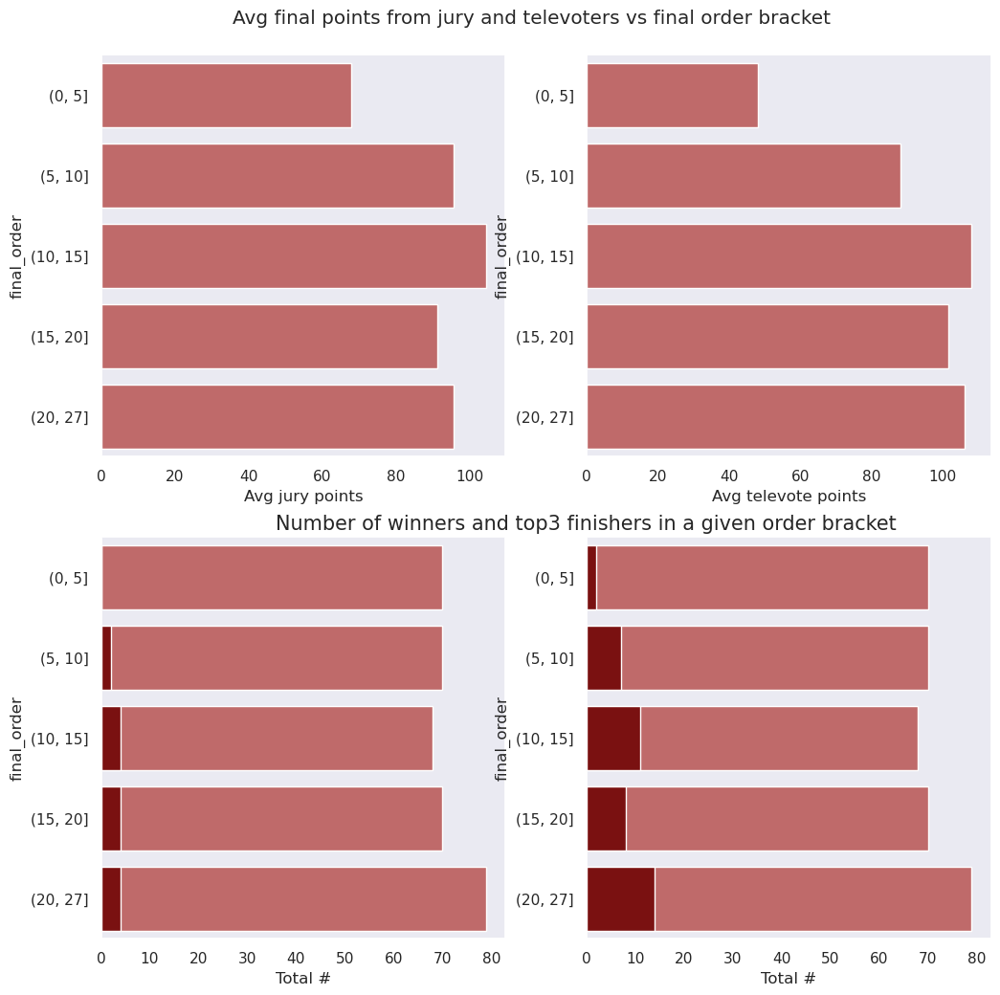

In [49]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2,2, figsize = (12,12))

plt.suptitle('Avg final points from jury and televoters vs final order bracket', y = 0.92)

sns.barplot(data = order.reset_index(), x = 'Avg jury points', y = 'final_order', 
           color = 'indianred', ax = ax1)
sns.barplot(data = order.reset_index(), x = 'Avg televote points', y = 'final_order', 
           color = 'indianred', ax = ax2)

plt.text(0, -0.6, 'Number of winners and top3 finishers in a given order bracket', 
         size = 15, horizontalalignment='center')

sns.barplot(data = order.reset_index(), x = 'Total #', y = 'final_order', color = 'indianred', ax = ax3)
sns.barplot(data = order.reset_index(), x = 'Winner #', y = 'final_order', color = 'darkred', ax = ax3)
sns.barplot(data = order.reset_index(), x = 'Total #', y = 'final_order', color = 'indianred', ax = ax4)
sns.barplot(data = order.reset_index(), x = 'Top3 #', y = 'final_order', color = 'darkred', ax = ax4)

There is no clear evidence for a recency bias, however the performers who start the competition seem to be at significant disadvantage.  
Out of 70 songs that were performed at the begining of the show (first 5 performances) only 2 finished in top3.

In [1]:
from ydata_profiling import ProfileReport

In [31]:
profile = ProfileReport(euro_df, title='Profile Report')

In [32]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]